### Camera Calibration and Distortion
Using a set of images of a Chessboard, first calibrate the camera finding the **intrinsic_parameters** and then apply a correction to the image that removes the distorsion.

* Use **cv2.findChessboardCorners()** to find corners in chessboard images and aggregate arrays of image points (2D image plane points) and object points (3D world points)
* Use the OpenCV function **cv2.calibrateCamera()** to compute the calibration matrices and distortion coefficients
* Use **cv2.undistort()** to undistort a test image.


![title](orig-and-undist.png)

In [14]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

plt.rcParams.update({'figure.max_open_warning': 0})

### Find Corners
For each Calibration Image, extract the corners of the chessboard in the image, knowing the number of corners along the x-axis (nx) and the number of corners along the y-axis (ny)

![title](sample.png)

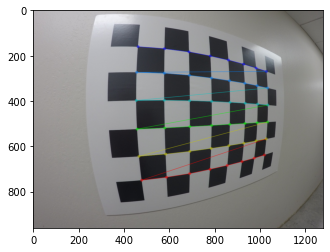

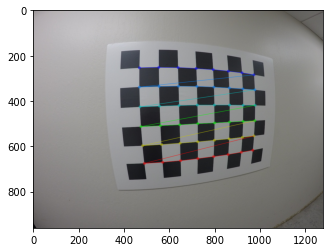

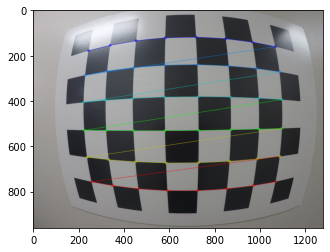

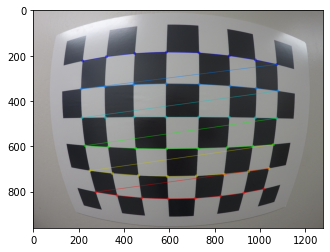

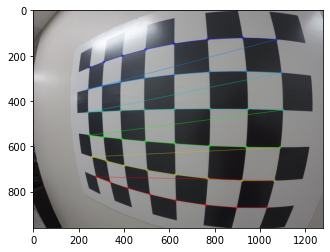

...

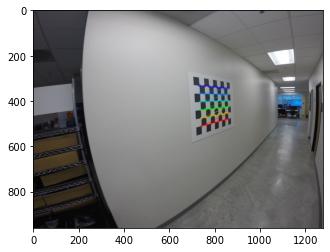

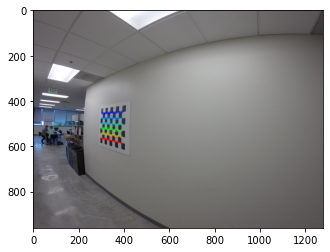

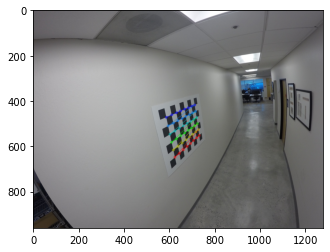

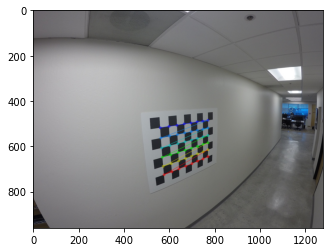

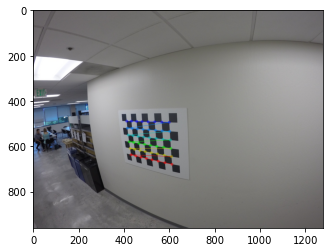

In [15]:
nx = 8
ny = 6
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((ny * nx,3), np.float32)
objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./calib/GOPR00*.jpg')

# Step through the list and search for chessboard corners
for idx, fname in enumerate(images):
    img = mpimg.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        
        # Draw and display the corners
        cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
        fig = plt.figure(idx+1)
        imgplot = plt.imshow(img)

### Calibrate the Camera
Calculate the Distorsion coefficients and the calibration matrix

In [16]:
img_size = (img.shape[1], img.shape[0])

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)

### Undistort the Image
Using the Distorsion parameters and the Calibration Matrix, remove the distrsion from the image

<Figure size 432x288 with 0 Axes>

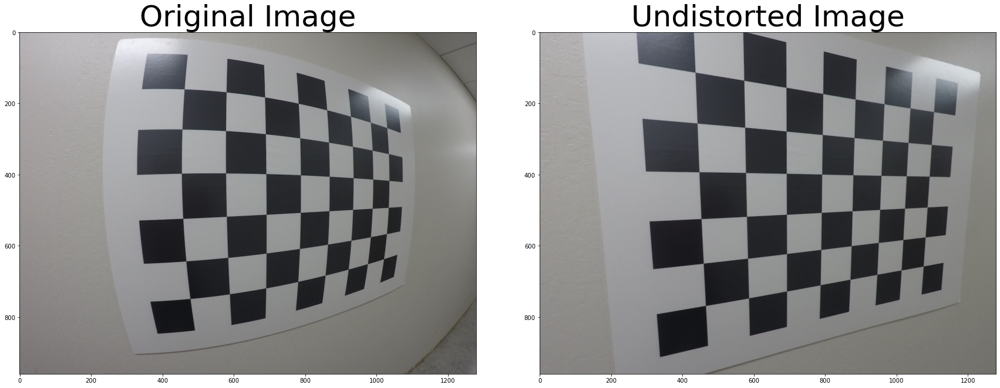

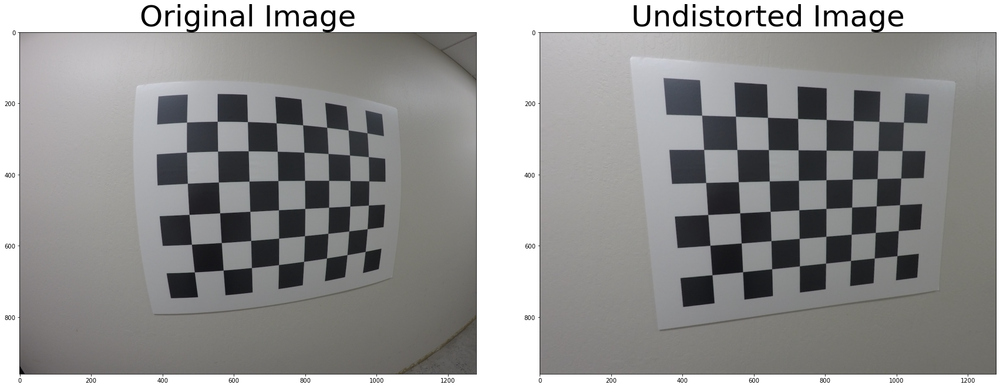

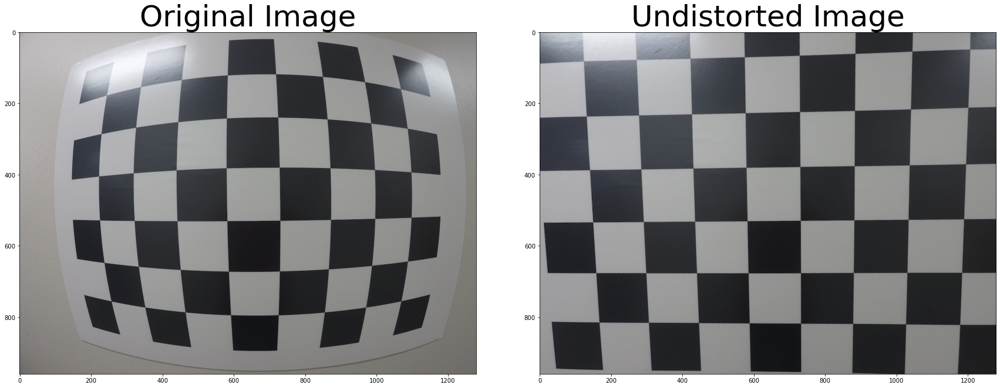

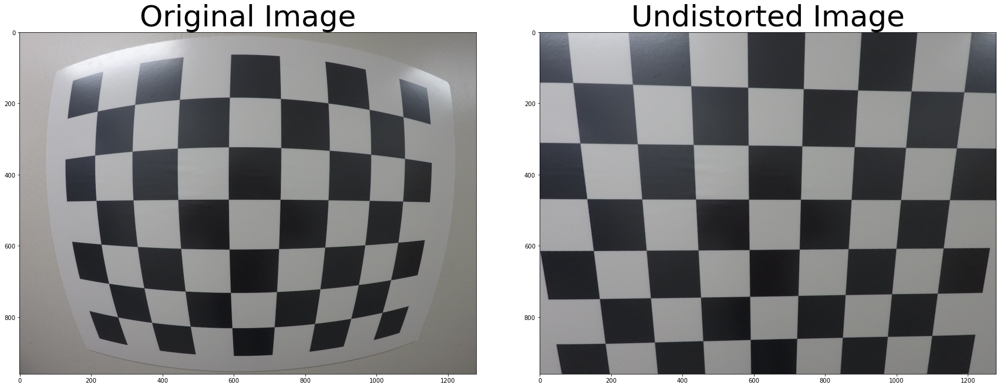

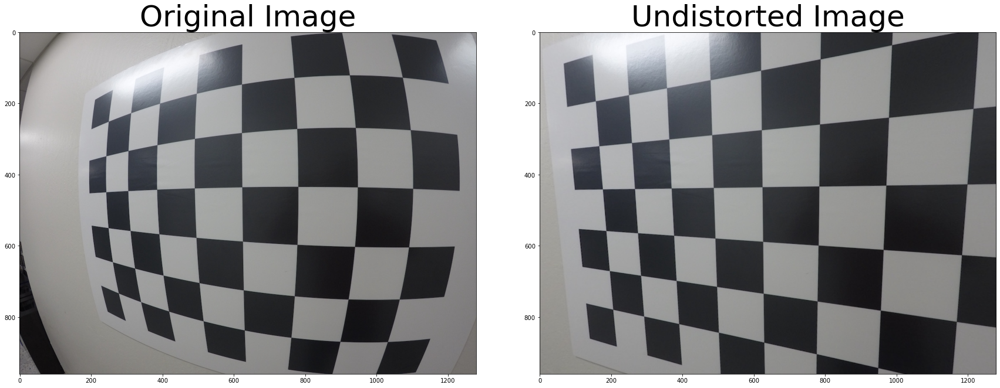

...

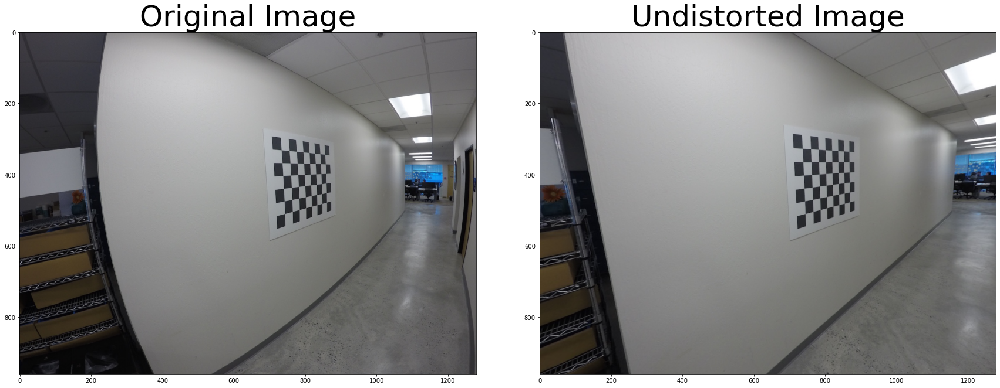

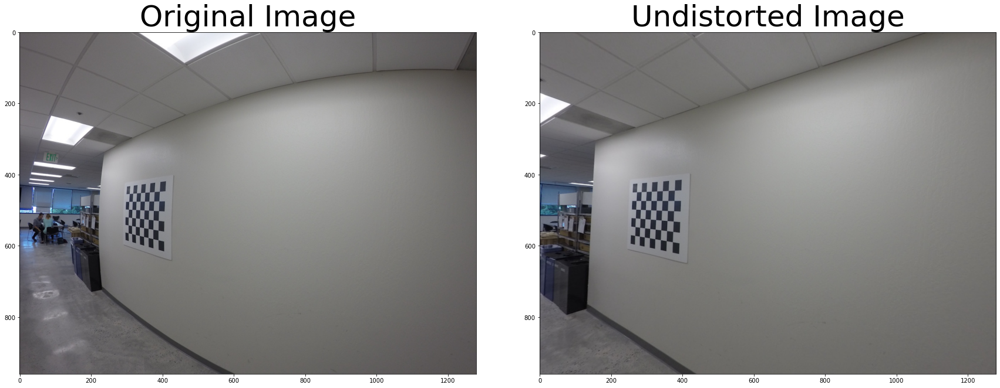

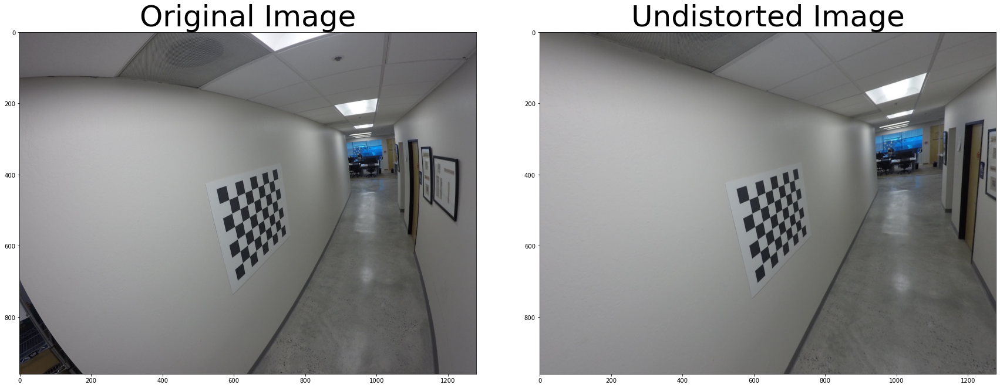

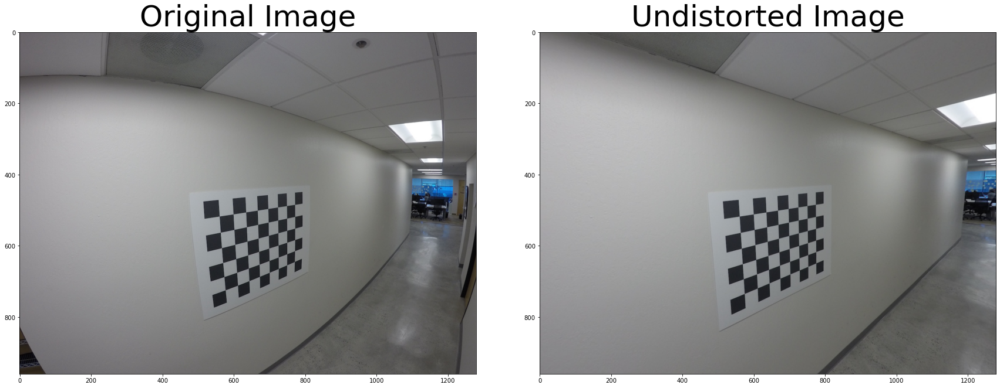

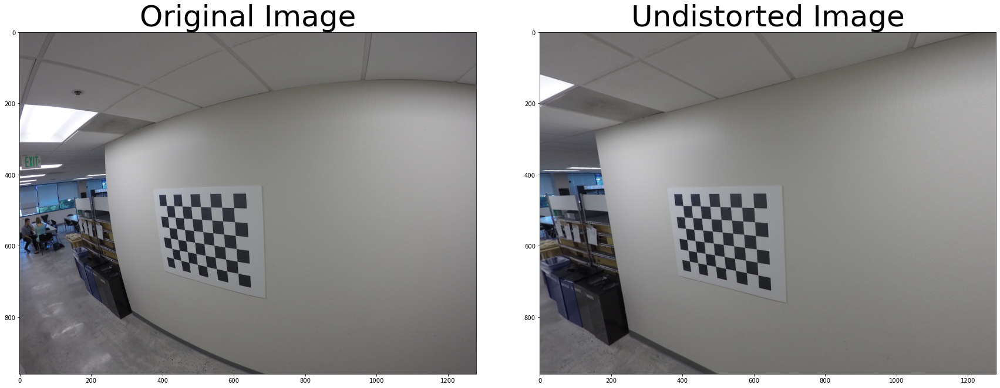

In [17]:
# Perform undistortion
for idx, fname in enumerate(images):
    img = mpimg.imread(fname)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    
    # Visualize undistortion
    fig = plt.figure(idx+1)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(undist)
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)